<a href="https://colab.research.google.com/github/mukindiru/SFCML_Assignments/blob/main/FeatureEngineering_WedWeek7.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Backgroud Information

You work for Koppokoppo, a company that offers market-appropriate solutions to enable and incentivize businesses to go digital. The company partners with financial institutions, mobile operators and major retailers who are interested in marketing new payment services to small and medium enterprises. In turn, the company offers small and medium enterprises loans.


# Defining the Question

### a) Specifying the Data Analysis Question

A model that will allow Koppokoppo to provide a solution is able to predict whether a loan offered to the certain small and medium enterprise will be paid off

### b) Defining the Metric for Success

1. Data analysis that points out relationship between various customer features and probability of default
2. Predictive model with high accuracy & precistions scores

### c) Understanding the Context

It's imperative for a lending company to be able to evaluate the credit quality of their prospective borrowers. This is important for not only minimizing credit risk but also to be in a position to maximize on the good borrowers

### d) Recording the Experimental Design

1. Collect data
2. Analyse the data
3. Model the data
4. Observations and recommendations

### e) Data Relevance

The data provided is relevant for the task

# Importing, Preparing & Understanding the Data

### Import / Install Libraries, Import the data & basic inspection / clean-up

In [54]:
#for data eda & analysis
#!pip install dataprep

In [55]:
#!pip install catboost

In [56]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib as plt

# displaying all columns
pd.set_option('display.max.columns', None)

# displaying the entire contents of a cell
pd.set_option('display.max_colwidth', None)

In [57]:
#import the data

dataseturl = 'https://raw.githubusercontent.com/risenW/Practical_feature_engineering_guide/master/sendy_logistics.csv'
dataset = pd.read_csv(dataseturl)

#dataset = dataset.replace(r"^ +| +$", r"", regex=True)

dataset.head()

,Order No,User Id,Vehicle Type,Platform Type,Personal or Business,Placement - Day of Month,Placement - Weekday (Mo = 1),Placement - Time,Confirmation - Day of Month,Confirmation - Weekday (Mo = 1),Confirmation - Time,Arrival at Pickup - Day of Month,Arrival at Pickup - Weekday (Mo = 1),Arrival at Pickup - Time,Pickup - Day of Month,Pickup - Weekday (Mo = 1),Pickup - Time,Arrival at Destination - Day of Month,Arrival at Destination - Weekday (Mo = 1),Arrival at Destination - Time,Distance (KM),Temperature,Precipitation in millimeters,Pickup Lat,Pickup Long,Destination Lat,Destination Long,Rider Id,Time from Pickup to Arrival
0,Order_No_4211,User_Id_633,Bike,3,Business,9,5,9:35:46 AM,9,5,9:40:10 AM,9,5,10:04:47 AM,9,5,10:27:30 AM,9,5,10:39:55 AM,4,20.4,NaN,-1.317755,36.830370,-1.300406,36.829741,Rider_Id_432,745
1,Order_No_25375,User_Id_2285,Bike,3,Personal,12,5,11:16:16 AM,12,5,11:23:21 AM,12,5,11:40:22 AM,12,5,11:44:09 AM,12,5,12:17:22 PM,16,26.4,NaN,-1.351453,36.899315,-1.295004,36.814358,Rider_Id_856,1993
2,Order_No_1899,User_Id_265,Bike,3,Business,30,2,12:39:25 PM,30,2,12:42:44 PM,30,2,12:49:34 PM,30,2,12:53:03 PM,30,2,1:00:38 PM,3,NaN,NaN,-1.308284,36.843419,-1.300921,36.828195,Rider_Id_155,455
3,Order_No_9336,User_Id_1402,Bike,3,Business,15,5,9:25:34 AM,15,5,9:26:05 AM,15,5,9:37:56 AM,15,5,9:43:06 AM,15,5,10:05:27 AM,9,19.2,NaN,-1.281301,36.832396,-1.257147,36.795063,Rider_Id_855,1341
4,Order_No_27883,User_Id_1737,Bike,1,Personal,13,1,9:55:18 AM,13,1,9:56:18 AM,13,1,10:03:53 AM,13,1,10:05:23 AM,13,1,10:25:37 AM,9,15.4,NaN,-1.266597,36.792118,-1.295041,36.809817,Rider_Id_770,1214


In [58]:
#replace spaces in column names

dataset.columns = dataset.columns.str.replace(' - ', '_')
dataset.columns = dataset.columns.str.replace(' ', '')

In [59]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21201 entries, 0 to 21200
Data columns (total 29 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   OrderNo                             21201 non-null  object 
 1   UserId                              21201 non-null  object 
 2   VehicleType                         21201 non-null  object 
 3   PlatformType                        21201 non-null  int64  
 4   PersonalorBusiness                  21201 non-null  object 
 5   Placement_DayofMonth                21201 non-null  int64  
 6   Placement_Weekday(Mo=1)             21201 non-null  int64  
 7   Placement_Time                      21201 non-null  object 
 8   Confirmation_DayofMonth             21201 non-null  int64  
 9   Confirmation_Weekday(Mo=1)          21201 non-null  int64  
 10  Confirmation_Time                   21201 non-null  object 
 11  ArrivalatPickup_DayofMonth          21201

A number of columns look, at the first glance to be having the wrong data type. There is however need for more analysis in ordert to understand them, and their relevance before converting them

In [60]:
#convert columns to the correct data type

#dataset.xyz = dataset.xyz.astype('category')

In [61]:
#number of records
dataset.shape

(21201, 29)

In [62]:
#drop irrelevant columns 

#dataset.drop(columns = ['xyz'], inplace = True)

#columns will be omitted later after further analysis

In [63]:
#check for duplicates
dataset.duplicated().sum()

0

dataset has no duplicate rows

In [64]:
#drop duplicates
#dataset = dataset.drop_duplicates()
#dataset.shape

DataPrep Report
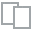
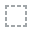
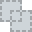
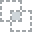
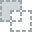
...
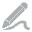
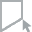
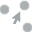
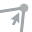
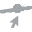

In [65]:
# dataset inpsection

from dataprep.eda import *

report = create_report(dataset)

report

**Initial observations**

1. Missing data
* Temparature column has 21% of the data missing
* Precipitation has 97.4% of the rows missing

2. Correlation
* Placement day of the month has perfect correlation with arrival pick up day of month, pick up day of month, pick up weekday, arrival destination day of month
* Placement weekday has perfect correlation with 1.confirmation weekday, arrival pickup weekday, pick up weekday and arrival destination weekday
* confirmation day of the month has perfect correlation with; arrival pickup day of month, pick up day of the month, arrival destination day of month
* confirmation weekday has perfect correlation with; arrival pickup weekday, pickup weekday,arrival destination weekday
* arrival pick up day of month has perfect correlation with pick up day of month, arrival destination day of month
* arrival pick up weekday has perfect correlation with pick up weekday

3. Several features have similar distributions

For purposes of our modeling, we will ignore

1. Features that have high correlation
2. Features that ordinarily would not be known at the time the rider is picking the order.
3. Features that do not provide much information, or have extremely high level or cardinality eg order id

As such, the following features shall be employed

1. Platform type
2. Personal or business
3. Placement day of the month
4. Placement weekday
5. Distance
6. Temparature

The target variable is TimeFromPickUpToArrival

In [66]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21201 entries, 0 to 21200
Data columns (total 29 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   OrderNo                             21201 non-null  object 
 1   UserId                              21201 non-null  object 
 2   VehicleType                         21201 non-null  object 
 3   PlatformType                        21201 non-null  int64  
 4   PersonalorBusiness                  21201 non-null  object 
 5   Placement_DayofMonth                21201 non-null  int64  
 6   Placement_Weekday(Mo=1)             21201 non-null  int64  
 7   Placement_Time                      21201 non-null  object 
 8   Confirmation_DayofMonth             21201 non-null  int64  
 9   Confirmation_Weekday(Mo=1)          21201 non-null  int64  
 10  Confirmation_Time                   21201 non-null  object 
 11  ArrivalatPickup_DayofMonth          21201

## Exploratory data analysis


From the above inspection, features to explore further are; 
1. Platform type
2. Personal or business
3. Placement day of the month
4. Placement weekday
5. Distance
6. Temparature

and how they relate with the target varialbe TimeFromPickUpToArrival

In [67]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21201 entries, 0 to 21200
Data columns (total 29 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   OrderNo                             21201 non-null  object 
 1   UserId                              21201 non-null  object 
 2   VehicleType                         21201 non-null  object 
 3   PlatformType                        21201 non-null  int64  
 4   PersonalorBusiness                  21201 non-null  object 
 5   Placement_DayofMonth                21201 non-null  int64  
 6   Placement_Weekday(Mo=1)             21201 non-null  int64  
 7   Placement_Time                      21201 non-null  object 
 8   Confirmation_DayofMonth             21201 non-null  int64  
 9   Confirmation_Weekday(Mo=1)          21201 non-null  int64  
 10  Confirmation_Time                   21201 non-null  object 
 11  ArrivalatPickup_DayofMonth          21201

### a. PlatformType


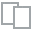
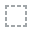
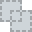
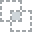
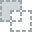
...
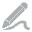
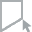
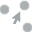
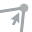
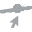

In [68]:
plot(dataset, 'PlatformType')


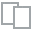
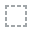
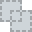
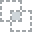
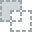
...
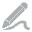
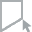
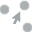
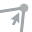
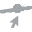

In [69]:
plot(dataset, 'PlatformType', 'TimefromPickuptoArrival')

### b. PersonalorBusiness


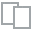
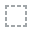
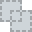
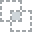
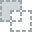
...
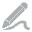
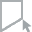
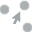
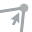
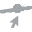

In [70]:
plot(dataset, 'PersonalorBusiness')


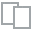
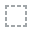
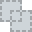
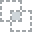
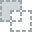
...
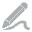
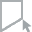
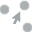
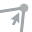
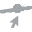

In [71]:
plot(dataset, 'PersonalorBusiness', 'TimefromPickuptoArrival')

### c. Placement_DayofMonth


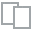
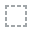
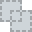
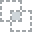
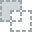
...
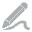
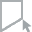
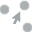
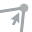
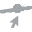

In [72]:
plot(dataset, 'Placement_DayofMonth')


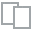
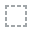
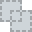
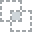
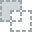
...
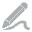
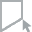
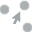
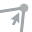
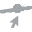

In [73]:
plot(dataset, 'Placement_DayofMonth', 'TimefromPickuptoArrival')

### c. Placement_Weekday(Mo=1)  


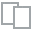
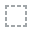
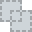
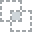
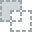
...
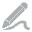
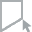
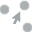
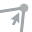
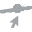

In [74]:
plot(dataset, 'Placement_Weekday(Mo=1)')


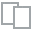
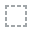
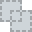
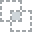
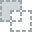
...
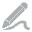
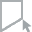
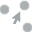
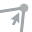
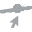

In [75]:
plot(dataset, 'Placement_Weekday(Mo=1)', 'TimefromPickuptoArrival')

### d. Distance(KM)


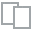
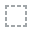
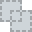
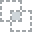
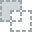
...
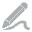
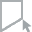
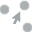
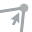
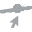

In [76]:
plot(dataset, 'Distance(KM)')



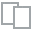
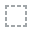
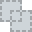
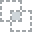
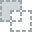
...
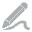
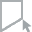
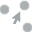
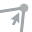
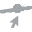

In [77]:
plot(dataset, 'Distance(KM)', 'TimefromPickuptoArrival' )

### e. Temperature


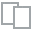
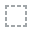
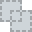
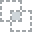
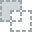
...
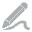
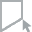
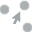
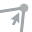
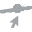

In [78]:
plot(dataset, 'Temperature')


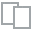
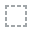
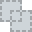
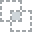
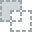
...
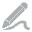
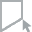
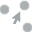
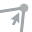
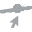

In [79]:
plot(dataset, 'Temperature','TimefromPickuptoArrival')

### g. Multi-collinearity


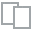
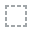
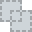
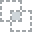
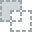
...
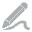
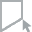
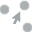
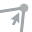
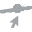

In [80]:
plot_correlation(dataset)

# Data pre-processng & Modeling

## 1. Base Model

In [81]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21201 entries, 0 to 21200
Data columns (total 29 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   OrderNo                             21201 non-null  object 
 1   UserId                              21201 non-null  object 
 2   VehicleType                         21201 non-null  object 
 3   PlatformType                        21201 non-null  int64  
 4   PersonalorBusiness                  21201 non-null  object 
 5   Placement_DayofMonth                21201 non-null  int64  
 6   Placement_Weekday(Mo=1)             21201 non-null  int64  
 7   Placement_Time                      21201 non-null  object 
 8   Confirmation_DayofMonth             21201 non-null  int64  
 9   Confirmation_Weekday(Mo=1)          21201 non-null  int64  
 10  Confirmation_Time                   21201 non-null  object 
 11  ArrivalatPickup_DayofMonth          21201

In [82]:
#check data types of the select columns

for column in ['PlatformType','PersonalorBusiness','Placement_DayofMonth','Placement_Weekday(Mo=1)','Distance(KM)','Temperature']:
    print(column, "is dtype:", dataset[column].dtype.name)

PlatformType is dtype: int64
PersonalorBusiness is dtype: object
Placement_DayofMonth is dtype: int64
Placement_Weekday(Mo=1) is dtype: int64
Distance(KM) is dtype: int64
Temperature is dtype: float64


In [83]:
#convert columns to the correct data type

#categorical columns
for col in ['PlatformType','PersonalorBusiness','Placement_DayofMonth','Placement_Weekday(Mo=1)']:
    dataset[col] = dataset[col].astype('category')

#object
#dataset.x = dataset.x.astype('object')

#numeric
#dataset.y = dataset.y.astype('int64')

#target variable
#dataset.z = dataset.z.astype('object')

for column in ['PlatformType','PersonalorBusiness','Placement_DayofMonth','Placement_Weekday(Mo=1)','Placement_DayofMonth','Distance(KM)','Temperature']:
    print("Column ", column, "is dtype:", dataset[column].dtype.name)

Column  PlatformType is dtype: category
Column  PersonalorBusiness is dtype: category
Column  Placement_DayofMonth is dtype: category
Column  Placement_Weekday(Mo=1) is dtype: category
Column  Placement_DayofMonth is dtype: category
Column  Distance(KM) is dtype: int64
Column  Temperature is dtype: float64


### Train, test split

In [84]:
# train & test data split

X = dataset[['PlatformType','PersonalorBusiness','Placement_DayofMonth', 'Placement_Weekday(Mo=1)','Distance(KM)','Temperature']]
y = dataset['TimefromPickuptoArrival']

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25)

In [85]:
X_train.describe(include=['category'])

,PlatformType,PersonalorBusiness,Placement_DayofMonth,Placement_Weekday(Mo=1)
count,15900,15900,15900,15900
unique,4,2,31,7
top,3,Business,8,4
freq,13527,13013,637,3190


In [86]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 15900 entries, 974 to 3921
Data columns (total 6 columns):
 #   Column                   Non-Null Count  Dtype   
---  ------                   --------------  -----   
 0   PlatformType             15900 non-null  category
 1   PersonalorBusiness       15900 non-null  category
 2   Placement_DayofMonth     15900 non-null  category
 3   Placement_Weekday(Mo=1)  15900 non-null  category
 4   Distance(KM)             15900 non-null  int64   
 5   Temperature              12586 non-null  float64 
dtypes: category(4), float64(1), int64(1)
memory usage: 436.7 KB


### Create transformers

In [87]:
from imblearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.impute import SimpleImputer

#Standardize numeric data
#Encode categorical data
numeric_transformer =  Pipeline(steps=[
                                       ('imputer', SimpleImputer(strategy='median')),
                                       ('scaler', StandardScaler())
])

categorical_transformer = Pipeline(steps=[
                                          ('imputer', SimpleImputer(strategy='constant',fill_value='missing')),
                                          ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

In [88]:
#select categorical columns
categorical_cols = ['PlatformType', 
                    'PersonalorBusiness',
                    'Placement_DayofMonth',
                    'Placement_Weekday(Mo=1)']

# Select numerical columns
numerical_cols = ['Distance(KM)',
                  'Temperature']


# Bundle preprocessing for numerical and categorical data
from sklearn.compose import ColumnTransformer

preprocessor = ColumnTransformer(
    transformers = [
                    ('num', numeric_transformer, numerical_cols),
                    ('cat', categorical_transformer, categorical_cols)
    ]
)

### Apply transformers on the dataset & create models

In [89]:
from sklearn.metrics import *
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVC, LinearSVC, NuSVC
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor

np.random.seed(3)

regressors = [
    #LinearRegression(),
    #KNeighborsRegressor(3),
    #SVC(kernel="rbf", C=0.025, probability = True),
    #NuSVC(probability=True),
    #DecisionTreeRegressor(),
    RandomForestRegressor(),
    AdaBoostRegressor(),
    GradientBoostingRegressor(),
    XGBRegressor(),
    LGBMRegressor(),
    CatBoostRegressor(verbose=False)
    ]

for regressor in regressors:
    pipe = Pipeline(steps=[('preprocessor', preprocessor),
                               ('regressor', regressor)
                               ])
    
    trainedmodel = pipe.fit(X_train, y_train)

    v_results = cross_val_score(regressor, X_train, y_train, cv = 3, 
                                     scoring='neg_root_mean_squared_error', n_jobs = -1, verbose = 0)
    
  
    # prediction
    y_predict = trainedmodel.predict(X_test)
    mse = mean_squared_error(y_test,y_predict)
    rmse = np.sqrt(mean_squared_error(y_test, y_predict))
    r2 = r2_score(y_test,y_predict)
  

    print('\n*******************************************************************')
    print(regressor)
    print("Model score: %.3f" % pipe.score(X_test, y_test))
    print('MAE: %.3f' % mse)
    print('Cross Validation Score: %.3f' % v_results.mean())
    print('RMSE:%.3f' % rmse)
    print('R2 Score:%.3f' % r2)

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
3 fits failed out of a total of 3.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
3 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_forest.py", line 328, in fit
    X, y, multi_output=True, accept_sparse="csc", dtype=DTYPE
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 581, in _validate_data
    X, y = check_X_y(X, y, **check_params)
  File "/usr/local/lib/python


*******************************************************************
RandomForestRegressor()
Model score: 0.229
MAE: 776634.922
Cross Validation Score: nan
RMSE:881.269
R2 Score:0.229


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
3 fits failed out of a total of 3.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
3 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_weight_boosting.py", line 1065, in fit
    return super().fit(X, y, sample_weight)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_weight_boosting.py", line 123, in fit
    y_numeric=is_regressor(self),
  File "/usr/local/lib/python3.7/dis


*******************************************************************
AdaBoostRegressor()
Model score: -0.149
MAE: 1157559.172
Cross Validation Score: nan
RMSE:1075.899
R2 Score:-0.149


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
3 fits failed out of a total of 3.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
3 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_gb.py", line 487, in fit
    X, y, accept_sparse=["csr", "csc", "coo"], dtype=DTYPE, multi_output=True
  File "/usr/local/lib/python3.7/dist-packages/sklearn/base.py", line 581, in _validate_data
    X, y = check_X_y(X, y, **check_params)
  File "/usr/loca


*******************************************************************
GradientBoostingRegressor()
Model score: 0.345
MAE: 659726.452
Cross Validation Score: nan
RMSE:812.235
R2 Score:0.345
[17:21:44] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
3 fits failed out of a total of 3.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
3 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.7/dist-packages/xgboost/sklearn.py", line 360, in fit
    trainDmatrix = DMatrix(X, label=y, missing=self.missing, nthread=self.n_jobs)
  File "/usr/local/lib/python3.7/dist-packages/xgboost/core.py", line 380, in __init__
    feature_types)
  File "/usr/local/lib/python3.7/dist-packages/x


*******************************************************************
XGBRegressor()
Model score: 0.346
MAE: 659562.725
Cross Validation Score: nan
RMSE:812.135
R2 Score:0.346

*******************************************************************
LGBMRegressor()
Model score: 0.337
MAE: 668310.962
Cross Validation Score: -808.315
RMSE:817.503
R2 Score:0.337

*******************************************************************
Model score: 0.331
MAE: 674127.539
Cross Validation Score: nan
RMSE:821.053
R2 Score:0.331


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
3 fits failed out of a total of 3.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
3 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.7/dist-packages/catboost/core.py", line 5593, in fit
    save_snapshot, snapshot_file, snapshot_interval, init_model, callbacks, log_cout, log_cerr)
  File "/usr/local/lib/python3.7/dist-packages/catboost/core.py", line 2270, in _fit
    callbacks=callbacks
  File "/usr/local/lib/python3.7

## 2. Improved model

To attempt improving the model perfomance, the following feature engineering will be employed
1. PCA
2. Manhattanc distance calculation

In [90]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21201 entries, 0 to 21200
Data columns (total 29 columns):
 #   Column                              Non-Null Count  Dtype   
---  ------                              --------------  -----   
 0   OrderNo                             21201 non-null  object  
 1   UserId                              21201 non-null  object  
 2   VehicleType                         21201 non-null  object  
 3   PlatformType                        21201 non-null  category
 4   PersonalorBusiness                  21201 non-null  category
 5   Placement_DayofMonth                21201 non-null  category
 6   Placement_Weekday(Mo=1)             21201 non-null  category
 7   Placement_Time                      21201 non-null  object  
 8   Confirmation_DayofMonth             21201 non-null  int64   
 9   Confirmation_Weekday(Mo=1)          21201 non-null  int64   
 10  Confirmation_Time                   21201 non-null  object  
 11  ArrivalatPickup_DayofMonth  

### 1. Distance between cordinates

In [91]:
from geopy.distance import vincenty

def distance_calc (row):
    start = (row['PickupLat'], row['PickupLong'])
    stop = (row['DestinationLat'], row['DestinationLong'])

    return vincenty(start, stop).meters

In [92]:
dataset['distance_1'] = dataset.apply (lambda row: distance_calc (row),axis=1)

In [93]:
dataset.head()

,OrderNo,UserId,VehicleType,PlatformType,PersonalorBusiness,Placement_DayofMonth,Placement_Weekday(Mo=1),Placement_Time,Confirmation_DayofMonth,Confirmation_Weekday(Mo=1),Confirmation_Time,ArrivalatPickup_DayofMonth,ArrivalatPickup_Weekday(Mo=1),ArrivalatPickup_Time,Pickup_DayofMonth,Pickup_Weekday(Mo=1),Pickup_Time,ArrivalatDestination_DayofMonth,ArrivalatDestination_Weekday(Mo=1),ArrivalatDestination_Time,Distance(KM),Temperature,Precipitationinmillimeters,PickupLat,PickupLong,DestinationLat,DestinationLong,RiderId,TimefromPickuptoArrival,distance_1
0,Order_No_4211,User_Id_633,Bike,3,Business,9,5,9:35:46 AM,9,5,9:40:10 AM,9,5,10:04:47 AM,9,5,10:27:30 AM,9,5,10:39:55 AM,4,20.4,NaN,-1.317755,36.830370,-1.300406,36.829741,Rider_Id_432,745,1919.585904
1,Order_No_25375,User_Id_2285,Bike,3,Personal,12,5,11:16:16 AM,12,5,11:23:21 AM,12,5,11:40:22 AM,12,5,11:44:09 AM,12,5,12:17:22 PM,16,26.4,NaN,-1.351453,36.899315,-1.295004,36.814358,Rider_Id_856,1993,11329.354281
2,Order_No_1899,User_Id_265,Bike,3,Business,30,2,12:39:25 PM,30,2,12:42:44 PM,30,2,12:49:34 PM,30,2,12:53:03 PM,30,2,1:00:38 PM,3,NaN,NaN,-1.308284,36.843419,-1.300921,36.828195,Rider_Id_155,455,1879.806198
3,Order_No_9336,User_Id_1402,Bike,3,Business,15,5,9:25:34 AM,15,5,9:26:05 AM,15,5,9:37:56 AM,15,5,9:43:06 AM,15,5,10:05:27 AM,9,19.2,NaN,-1.281301,36.832396,-1.257147,36.795063,Rider_Id_855,1341,4939.252800
4,Order_No_27883,User_Id_1737,Bike,1,Personal,13,1,9:55:18 AM,13,1,9:56:18 AM,13,1,10:03:53 AM,13,1,10:05:23 AM,13,1,10:25:37 AM,9,15.4,NaN,-1.266597,36.792118,-1.295041,36.809817,Rider_Id_770,1214,3711.035321


### 2. PCA transformer

In [98]:
from sklearn.decomposition import TruncatedSVD
pca = TruncatedSVD(n_components=5, n_iter=7, random_state=42)

### New model

In [99]:
# train & test data split

X = dataset[['PlatformType','Placement_DayofMonth', 'Placement_Weekday(Mo=1)','distance_1']]
y = dataset['TimefromPickuptoArrival']

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25)

In [100]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 15900 entries, 4358 to 10519
Data columns (total 4 columns):
 #   Column                   Non-Null Count  Dtype   
---  ------                   --------------  -----   
 0   PlatformType             15900 non-null  category
 1   Placement_DayofMonth     15900 non-null  category
 2   Placement_Weekday(Mo=1)  15900 non-null  category
 3   distance_1               15900 non-null  float64 
dtypes: category(3), float64(1)
memory usage: 296.9 KB


In [108]:
from imblearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.impute import SimpleImputer

#Standardize numeric data
#Encode categorical data
numeric_transformer =  Pipeline(steps=[
                                       #('imputer', SimpleImputer(strategy='median')),
                                       ('scaler', StandardScaler())
])

categorical_transformer = Pipeline(steps=[
                                          #('imputer', SimpleImputer(strategy='constant',fill_value='missing')),
                                          ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

In [109]:
#select categorical columns
categorical_cols = ['PlatformType',
                    'Placement_DayofMonth',
                    'Placement_Weekday(Mo=1)']

# Select numerical columns
numerical_cols = ['distance_1']


# Bundle preprocessing for numerical and categorical data
from sklearn.compose import ColumnTransformer

preprocessor = ColumnTransformer(
    transformers = [
                    ('num', numeric_transformer, numerical_cols),
                    ('cat', categorical_transformer, categorical_cols)
    ]
)

In [110]:
from sklearn.metrics import *
from sklearn.decomposition import PCA
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVC, LinearSVC, NuSVC
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor

np.random.seed(3)

regressors = [
    #LinearRegression(),
    #KNeighborsRegressor(3),
    #SVC(kernel="rbf", C=0.025, probability = True),
    #NuSVC(probability=True),
    #DecisionTreeRegressor(),
    RandomForestRegressor(),
    AdaBoostRegressor(),
    GradientBoostingRegressor(),
    XGBRegressor(),
    LGBMRegressor(),
    CatBoostRegressor(verbose=False)
    ]

for regressor in regressors:
    pipe = Pipeline(steps=[('preprocessor', preprocessor),
                           ('pca' , pca),
                           ('regressor', regressor)
                           ])
    
    trainedmodel = pipe.fit(X_train, y_train)

    v_results = cross_val_score(regressor, X_train, y_train, cv = 3, 
                                     scoring='neg_root_mean_squared_error', n_jobs = -1, verbose = 0)
    
  
    # prediction
    y_predict = trainedmodel.predict(X_test)
    mse = mean_squared_error(y_test,y_predict)
    rmse = np.sqrt(mean_squared_error(y_test, y_predict))
    r2 = r2_score(y_test,y_predict)
  

    print('\n*******************************************************************')
    print(regressor)
    print("Model score: %.3f" % pipe.score(X_test, y_test))
    print('MAE: %.3f' % mse)
    print('Cross Validation Score: %.3f' % v_results.mean())
    print('RMSE:%.3f' % rmse)
    print('R2 Score:%.3f' % r2)


*******************************************************************
RandomForestRegressor()
Model score: 0.239
MAE: 760643.221
Cross Validation Score: -856.908
RMSE:872.149
R2 Score:0.239

*******************************************************************
AdaBoostRegressor()
Model score: -0.139
MAE: 1138603.717
Cross Validation Score: -1029.062
RMSE:1067.054
R2 Score:-0.139

*******************************************************************
GradientBoostingRegressor()
Model score: 0.341
MAE: 658405.365
Cross Validation Score: -801.537
RMSE:811.422
R2 Score:0.341
[17:26:05] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
3 fits failed out of a total of 3.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
3 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.7/dist-packages/xgboost/sklearn.py", line 360, in fit
    trainDmatrix = DMatrix(X, label=y, missing=self.missing, nthread=self.n_jobs)
  File "/usr/local/lib/python3.7/dist-packages/xgboost/core.py", line 380, in __init__
    feature_types)
  File "/usr/local/lib/python3.7/dist-packages/x


*******************************************************************
XGBRegressor()
Model score: 0.343
MAE: 656796.717
Cross Validation Score: nan
RMSE:810.430
R2 Score:0.343

*******************************************************************
LGBMRegressor()
Model score: 0.332
MAE: 668015.405
Cross Validation Score: -811.336
RMSE:817.322
R2 Score:0.332

*******************************************************************
Model score: 0.329
MAE: 670522.257
Cross Validation Score: nan
RMSE:818.854
R2 Score:0.329


/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
3 fits failed out of a total of 3.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
3 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.7/dist-packages/catboost/core.py", line 5593, in fit
    save_snapshot, snapshot_file, snapshot_interval, init_model, callbacks, log_cout, log_cerr)
  File "/usr/local/lib/python3.7/dist-packages/catboost/core.py", line 2270, in _fit
    callbacks=callbacks
  File "/usr/local/lib/python3.7

# Summary of findings & recommendations

Highest score is by LGBMClassifer, with crossvalidated score of 93.1%